<a href="https://colab.research.google.com/github/yeivillamil/Team30_CV/blob/main/2_6_Image_enhancement_vF_Equipo_30.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

![Evidence 3](https://i.imgur.com/mu6ZuGT.jpg)

#**TC4033**

##**Visión computacional para imágenes y video**
##**2.6 Google Colab -  Image enhancement**

##**Docentes:** Dr. Gilberto Ochoa Ruiz, Mtra. María Guadalupe Marcos Abularach

##**Equipo 30:**
- Julio Baltazar Colín: A01794476
- Julio Osvaldo Hernández Bucio: A01794366
- Helmy Andrea Moreno Navarro: A01793918
- Maricel Parra Osorio - A01793932
- Yeison Fernando Villamil Franco: A01793803

# 2. Image Enhancement

## Table of Contents
1. [Introducción](#Introducción)
1. [Libraries](#libraries)
2. [Histogram Equalization](#hist)
3. [Denoising with Filters](#denoising)
4. [Challenge](#challenge)

  - 1. [Método tile-based histogram equalization](#tile-based )
  - 2. [Método Sliding Window Adaptive Histogram Equalization (SWAHE)](#SWAHE)
  - 3. [Algoritmo Contrast Limited Adaptive Histogram Equalization (CLAHE)](#CLAHE)

# **Introducción**

> <h4>En el presente desarrollo podremos ver la diferencia que existe al analizar imágenes de manera global como locales. Inicialmente se dan unos ejemplos de cómo se pueden analizar las imagenes de manera genérica y como sus valores se modifican en caso de requerir ajustes de una imagen.</h4>

> <h4>Aplicando los métodos Tile-Based Histogram Equalization <b>(TBHE)</b>, Sliding Window Adaptive Histogram Equalization <b>(SWAHE)</b> y Contrast Limited Adaptive Histogram Equalization <b>(CLAHE)</b> podemos ver que el procesamiento de la imagen se especifica y trabaja a su vez por bloques de acuerdo a la cualidad que se desee obtener, ya sean el análisis de sus contrastes, de brillos, de sus valores en escalas de grises, entre otras.</h4>

## **1. Importing Libraries** <a class="anchor" id="libraries" ></a>

In [ ]:
!pip install numpy

In [ ]:
!pip install opencv-python

In [ ]:
!pip install matplotlib

In [ ]:
!pip install image_slicer

In [ ]:
!pip install requests

In [ ]:
from PIL import Image, ImageOps
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.image as mpimg
from skimage import exposure
import skimage
from scipy.ndimage.filters import gaussian_filter as gauss
from scipy.ndimage.filters import median_filter as med
import cv2

<ipython-input-6-0238ad4d13f7>:7: DeprecationWarning: Please use `gaussian_filter` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  from scipy.ndimage.filters import gaussian_filter as gauss
<ipython-input-6-0238ad4d13f7>:8: DeprecationWarning: Please use `median_filter` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  from scipy.ndimage.filters import median_filter as med


## **Cargue de imagen**

In [ ]:
import cv2
import matplotlib.pyplot as plt
from io import BytesIO
import matplotlib.pyplot as plt
import requests

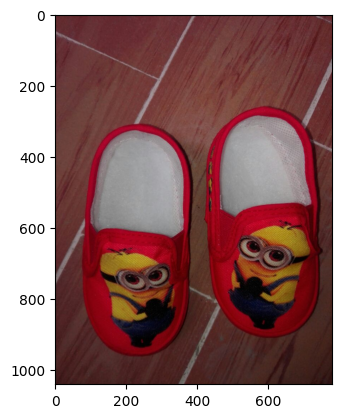

In [ ]:
original_image = Image.open('data/image.jpg')
plt.imshow(original_image)
type(original_image)

# Save the image
np.save('data/img.npy', original_image)

#Load the image
original_image = np.load('data/img.npy')

## **2. Histogram Equalization**<a class="anchor" id="hist" ></a>

Let's look at the distribution of pixel values in the image.

Ideally, the image should have relatively even distribution of values, indicating good contrast and making it easier to extract analytical information.

An easy way to check this is to plot a histogram.

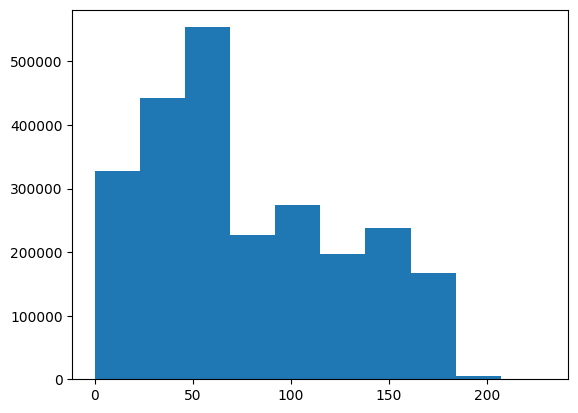

In [ ]:
# Plot a histogram - we need to use ravel to "flatten" the 3 dimensions
plt.hist(original_image.ravel())
plt.show()

Another useful way to visualize the statistics of an image is as a cumulative distribution function (CDF) plot. Which shows the cumulative pixel intensity frequencies from 0 to 255.

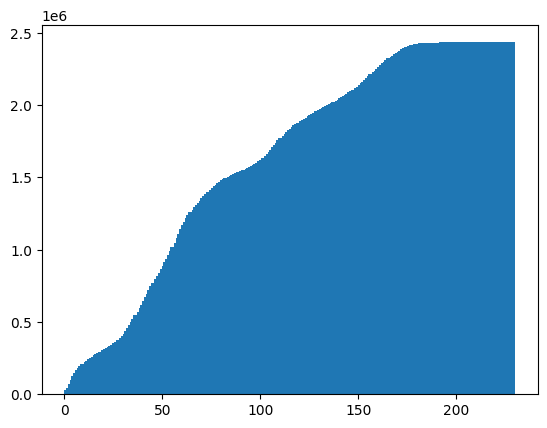

In [ ]:
plt.hist(original_image.ravel(), bins=255, cumulative=True)
plt.show()

The histogram and CDF for our image show pretty uneven distribution - there's a lot of contrast in the image. Ideally we should equalize the values in the images we want to analyse to try to make our images more consistent in terms of the shapes they contain irrespective of light levels.

Histogram equalization is often used to improve the statistics of images. In simple terms, the histogram equalization algorithm attempts to adjust the pixel values in the image to create a more uniform distribution. The code in the cell below uses the  **exposure.equalize_hist** method from the **skimage** package to equalize the image.  

/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: This might be a color image. The histogram will be computed on the flattened image. You can instead apply this function to each color channel, or set channel_axis.
  return func(*args, **kwargs)


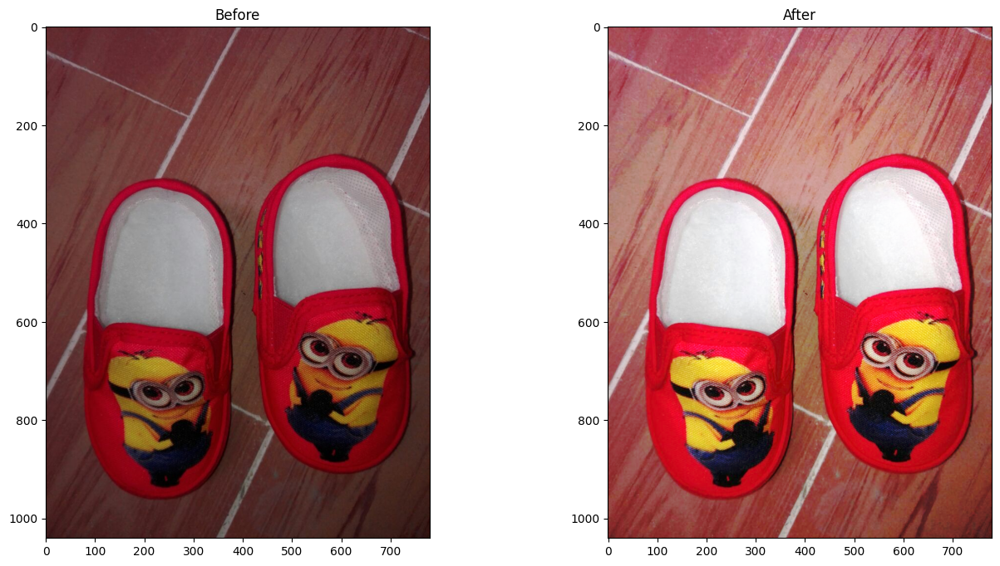

In [ ]:
original_image_eq = exposure.equalize_hist(original_image)

fig = plt.figure(figsize=(16, 8))

# Subplot for original image
a=fig.add_subplot(1,2,1)
imgplot = plt.imshow(original_image)
a.set_title('Before')

# Subplot for processed image
a=fig.add_subplot(1,2,2)
imgplot = plt.imshow(original_image_eq)
a.set_title('After')

plt.show()

As with most image operations, there's more than one way to do this. For example, you could also use the **PIL.ImgOps.equalize** method:

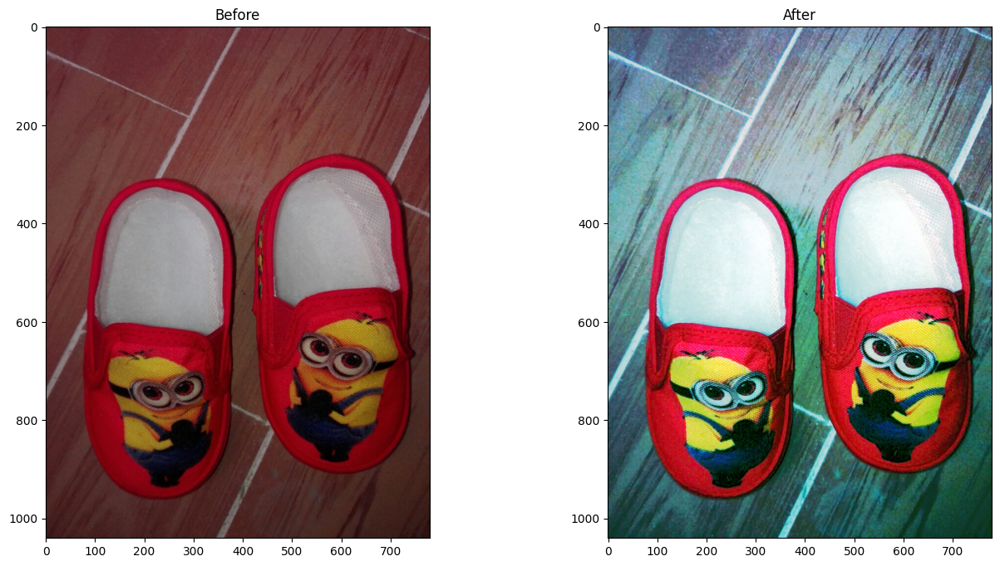

In [ ]:
# Equalize the image - but we need to convert the numpy array back to the PIL image format
image_PIL_eq = ImageOps.equalize(Image.fromarray(original_image))

# Display using matplotlib

# Create a figure
fig = plt.figure(figsize=(16, 8))

# Subplot for original image
a=fig.add_subplot(1,2,1)
imgplot = plt.imshow(original_image)
a.set_title('Before')

# Subplot for processed image
a=fig.add_subplot(1,2,2)
imgplot = plt.imshow(image_PIL_eq)
a.set_title('After')

plt.show()

Now let's see what that's done to the histogram and CDF plots:

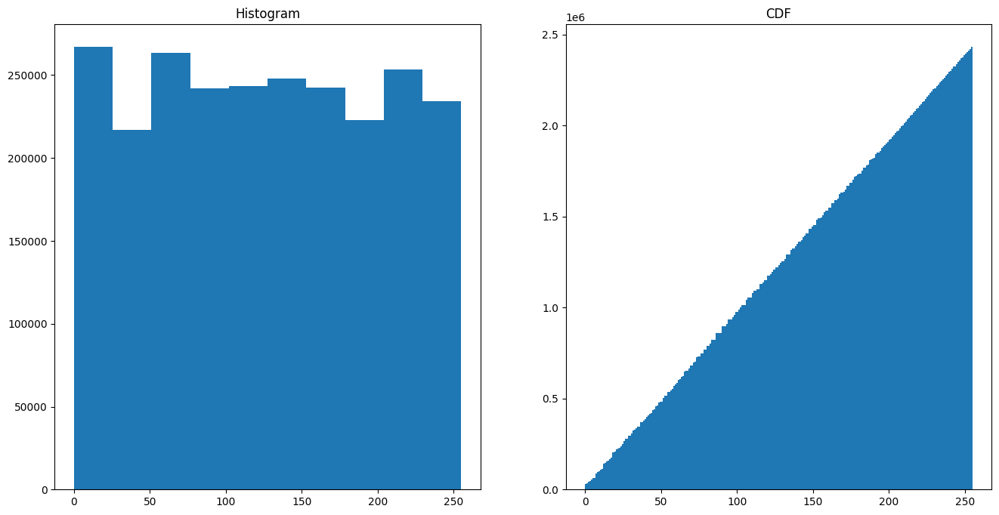

In [ ]:
# Display histograms
img_eq = np.array(image_PIL_eq)

# Create a figure
fig = plt.figure(figsize=(16, 8))

# Subplot for original image
a=fig.add_subplot(1,2,1)
imgplot = plt.hist(img_eq.ravel())
a.set_title('Histogram')

# Subplot for processed image
a=fig.add_subplot(1,2,2)
imgplot = plt.hist(img_eq.ravel(), bins=255, cumulative=True)
a.set_title('CDF')

plt.show()

The pixel intensities are more evenly distributed in the equalized image. In particular, the cumulative density shows a straight diagonal cumulation; which is a good sign that the pixel intensity values have been equalized.

## **3. Denoising with Filters** <a class="anchor" id="denoising" ></a>

Often images need to be cleaned up to remove "salt and pepper" noise.

### **- Add Some Random Noise**
Let's add some random noise to our image - such as you might see in a photograph taken in low light or at a low resolution.

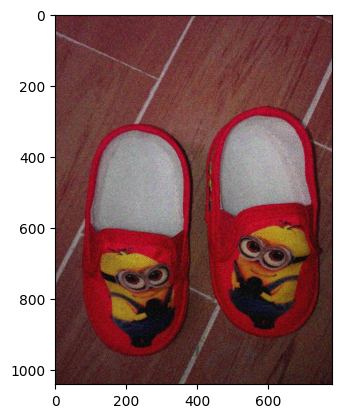

In [ ]:
img_n = skimage.util.random_noise(original_image)
plt.imshow(img_n)

### **- Using a Gaussian Filter**
A Gaussian filter applies a weighted average (mean) value for pixels based on the pixels that surround them.

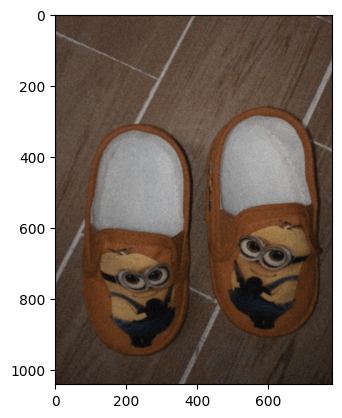

In [ ]:
img3_gauss = gauss(img_n, sigma=1)
plt.imshow(img3_gauss)

### **- Using a Median Filter**
The Gaussian filter results in a blurred image, which may actually be better for feature extraction as it makes it easier to find contrasting areas. If it's too blurred, we could try a median filter, which as the name suggests applies the median value to pixels based on the pixels around them.

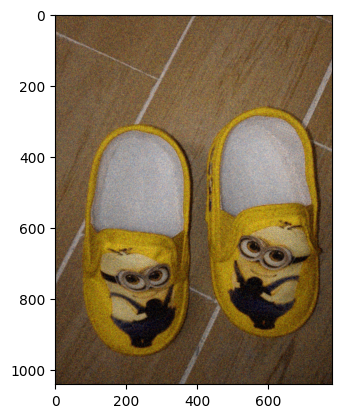

In [ ]:
img_med = med(img_n, size=2)
plt.imshow(img_med)

## **4. Challenge** <a class="anchor" id="challenge" ></a>

Now, try solving this challenge, you must equalize different windows of the same image in a splitted way.

In [ ]:
from image_slicer import slice

n = 4
slice('data/image.jpg', n)

(<Tile #1 - image_01_01.png>,
 <Tile #2 - image_01_02.png>,
 <Tile #3 - image_02_01.png>,
 <Tile #4 - image_02_02.png>)

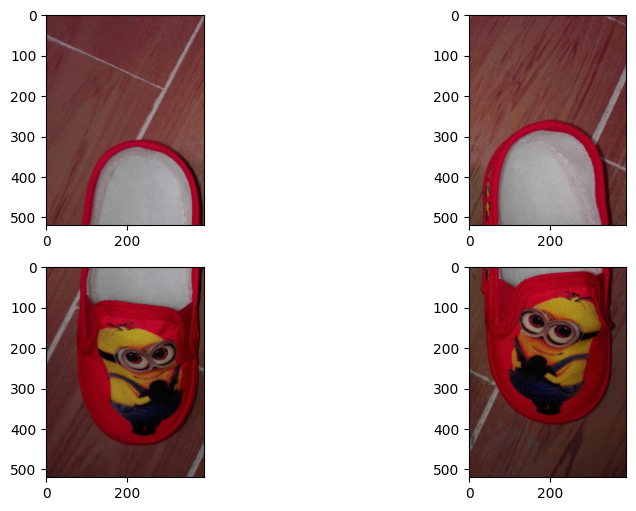

In [ ]:
fig = plt.figure(figsize=(10, 6))

plt.subplot(2,2,1)
img = Image.open(f'data/image_01_01.png')
plt.imshow(img)

plt.subplot(2,2,2)
img = Image.open(f'data/image_01_02.png')
plt.imshow(img)

plt.subplot(2,2,3)
img = Image.open(f'data/image_02_01.png')
plt.imshow(img)

plt.subplot(2,2,4)
img = Image.open(f'data/image_02_02.png')
plt.imshow(img)

plt.show()

#**Práctica**

### **1. Investiga e implementa el método tile-based histogram equalization. En estos métodos, la imagen se particiona en diferentes ventanas (i.e. mosaicos) y los histogramas se calculan de forma independiente, aplicando la corrección sobre cada ventana. Existe un compromiso entre el tamaño de la ventana y la complejidad computacional, por lo cual es más complejo que el método simple. Implementa esta versión y realiza algunas pruebas variando el tamaño de la ventana. Otro inconveniente es que se puede observar posibles diferencias entre los el contraste de los bloques, **¿Cómo podría mejorarse?**



#### **Método Tile-Based Histogram Equalization (TBHE)**

El método Tile-Based Histogram Equalization (TBHE) es una técnica de procesamiento de imágenes que surge como una variante de la equalización de histograma global tradicional. A diferencia de la equalización global, el TBHE opera aplicando el concepto de ecualización de histograma de manera local sobre secciones o mosaicos específicos de la imagen, en lugar de hacerlo de manera global en toda la imagen[1]. Los pasos principales de este método son los siguientes:

##### **División de la Imagen en Mosaicos:**
La imagen se divide en ventanas o mosaicos más pequeños. Cada uno de estos mosaicos será tratado de forma independiente durante el proceso de ecualización de histograma, lo que permite considerar las características locales de la imagen[2].

#####**Cálculo de Histogramas Locales:**
Para cada mosaico, se calcula su propio histograma. Este histograma refleja la distribución de intensidades de píxeles dentro de ese mosaico específico[1].

#####**Equalización de Histograma por Mosaico:**
Se aplica la corrección por ecualización de histograma de manera independiente en cada mosaico. Esto implica ajustar las intensidades de los píxeles dentro de cada mosaico para lograr una distribución más uniforme[3].

#####**Reconstrucción de la Imagen:**
Después de realizar la ecualización en cada mosaico, se reconstruye la imagen combinando los mosaicos procesados. El resultado final es una imagen en la que se ha mejorado el contraste localmente[1].

Esto permite resaltar el contraste de forma adaptativa en diferentes regiones de la imagen, reduciendo el sobre-procesamiento [2].

####**Referencias bibliográficas:**

[1] S.M. Pizer et al., "Adaptive Histogram Equalization and its Variations", Comput. Vision Graph. Image Process. 39 286-298 (1987).

[2] Y.T. Kim, "Contrast enhancement using brightness preserving bi-histogram equalization," IEEE Trans. Consum. Electron., vol. 43, no. 1, pp. 1-8, Feb 1997.

[3] S. S. Bedi, Rati Khandelwal, "Various Image Enhancement Techniques- A Critical Review", International Journal of Advanced Research in Computer and Communication Engineering Vol. 2, Issue 3, March 2013.

#### **Implementación**

/usr/local/lib/python3.10/dist-packages/skimage/io/manage_plugins.py:23: UserWarning: Your installed pillow version is < 8.1.2. Several security issues (CVE-2021-27921, CVE-2021-25290, CVE-2021-25291, CVE-2021-25293, and more) have been fixed in pillow 8.1.2 or higher. We recommend to upgrade this library.
  from .collection import imread_collection_wrapper


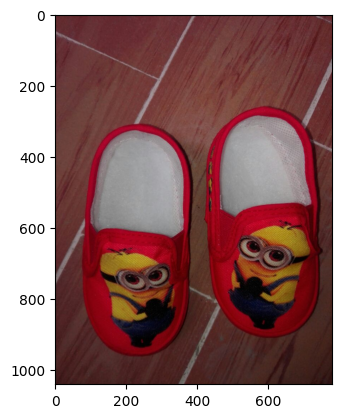

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import skimage.exposure as exposure

# Update the image
image = skimage.io.imread('data/image.jpg')

plt.imshow(image)
type(image)

# Save the image
np.save('data/img.npy', image)

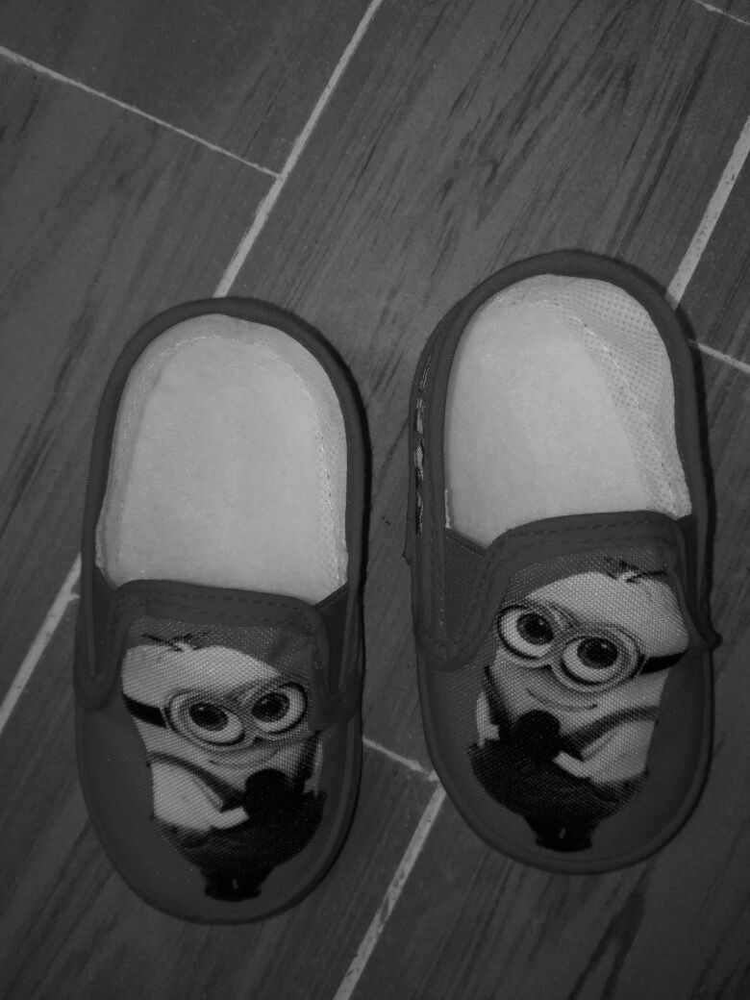

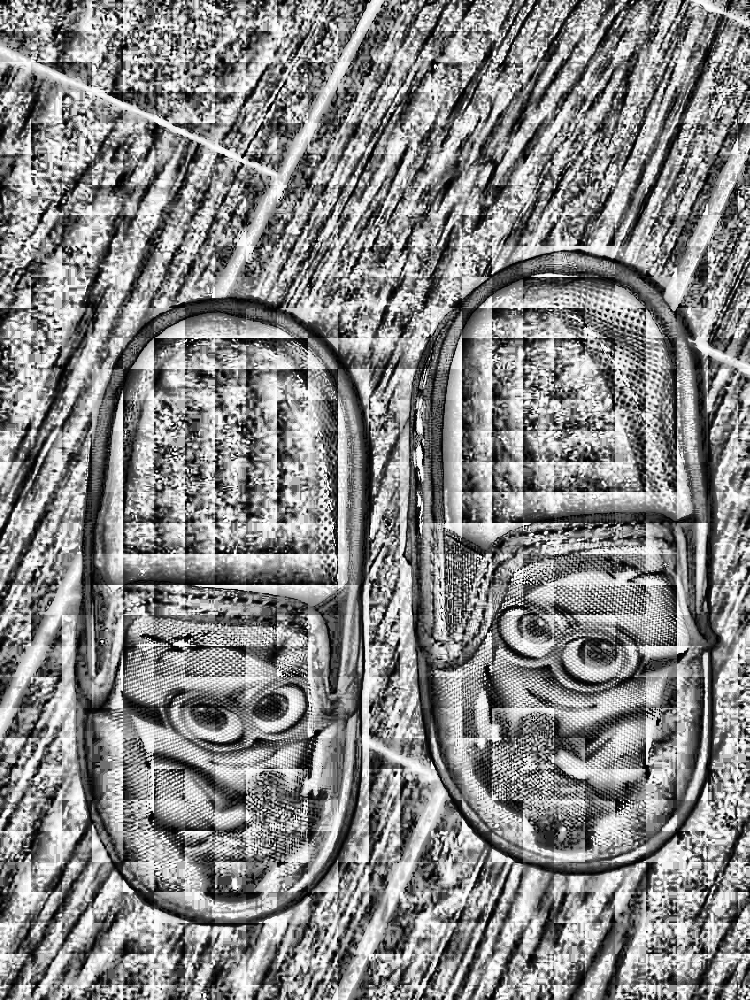

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

def tile_based_histogram_equalization(image, tile_size):
    height, width = image.shape
    result_image = np.zeros_like(image, dtype=np.uint8)

    for i in range(0, height, tile_size):
        for j in range(0, width, tile_size):
            tile = image[i:i+tile_size, j:j+tile_size]
            tile_histogram, _ = np.histogram(tile.flatten(), bins=256, range=[0, 256], density=True)
            cumulative_distribution = np.cumsum(tile_histogram)
            cumulative_distribution = (cumulative_distribution * 255).astype(np.uint8)

            tile_equalized = np.interp(tile, np.arange(256), cumulative_distribution)
            result_image[i:i+tile_size, j:j+tile_size] = tile_equalized

    return result_image

# Cargar la imagen
image_path = 'data/image.jpg'
original_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Tamaño de la ventana (mosaico)
window_size = 32

# Aplica el método Tile-Based Histogram Equalization
equalized_image = tile_based_histogram_equalization(original_image, window_size)

# Mostrar las imágenes original y equalizada
cv2_imshow(original_image)
cv2_imshow(equalized_image)


Podemos observar variaciones de contraste entre los bloques de la imagen. Para mitigar esta disparidad y mejorar la transición visual, se emplean técnicas de interpolación, como la interpolación bilineal.

La interpolación bilineal es un método utilizado para estimar valores intermedios entre los píxeles vecinos en una imagen. Este proceso se lleva a cabo después de realizar la equalización de histograma en cada bloque individual. En lugar de presentar transiciones bruscas entre bloques, la interpolación bilineal suaviza estas transiciones al ponderar de manera equilibrada los valores de los píxeles circundantes.

Es importante destacar que la interpolación no se limita únicamente al interior de cada bloque; también se aplica en las regiones que limitan dichos bloques. El propósito de esta técnica es suavizar las transiciones entre bloques adyacentes, buscando lograr una apariencia visual más coherente en la imagen final.

Para lo anterior, se usará la función cv2.resize de OpenCV con el método de interpolación deseado, como cv2.INTER_LINEAR:

Esto ayuda a suavizar las transiciones entre bloques y mejorar la coherencia del contraste en la imagen final. Se puede ajustar el método de interpolación y el tamaño de la ventana.





---



Ventana de tamaño 16x16:


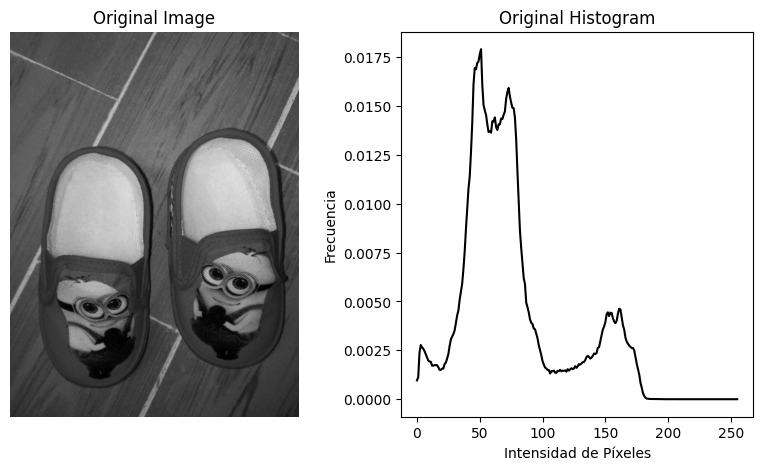

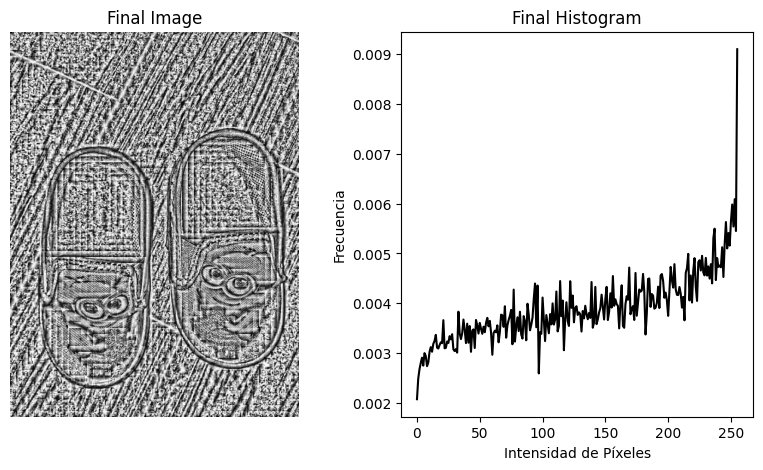

Ventana de tamaño 32x32:


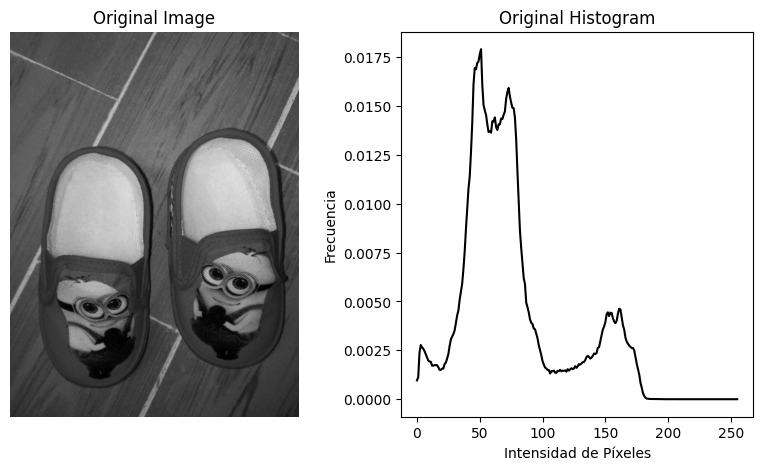

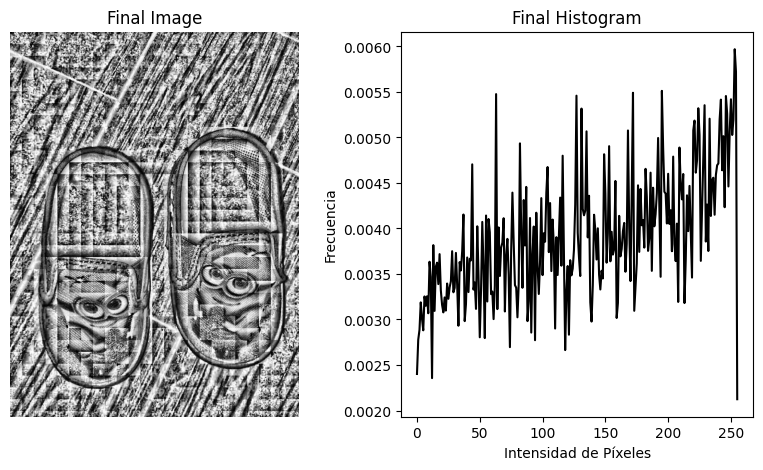

Ventana de tamaño 64x64:


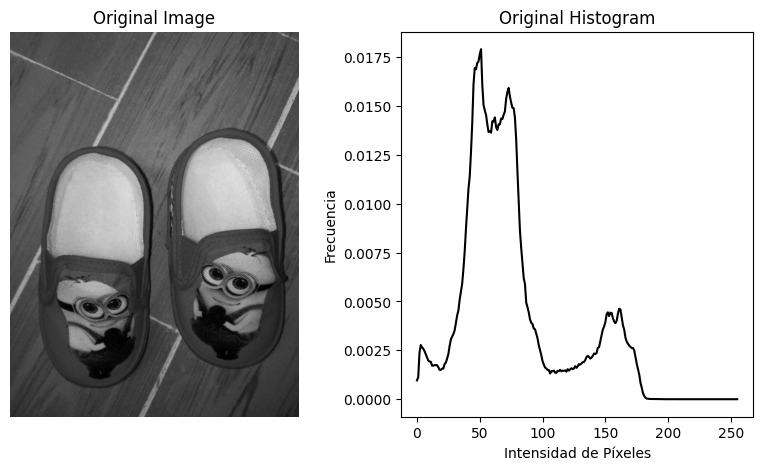

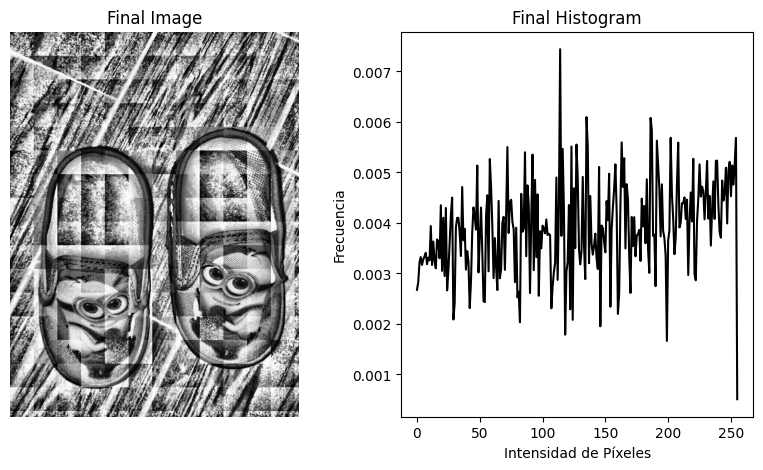

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def plot_image_and_histogram(image, histogram, title_image, title_histogram):
    plt.figure(figsize=(10, 5))

    # Gráfica la imagen
    plt.subplot(1, 2, 1)
    plt.imshow(image, cmap='gray')
    plt.title(title_image)
    plt.axis('off')

    # Graficar histograma
    plt.subplot(1, 2, 2)
    plt.plot(histogram, color='black')
    plt.title(title_histogram)
    plt.xlabel('Intensidad de Píxeles')
    plt.ylabel('Frecuencia')

    plt.show()

def tile_based_histogram_equalization_with_interpolation(image, tile_size):
    height, width = image.shape
    result_image = np.zeros_like(image, dtype=np.uint8)

    for i in range(0, height, tile_size):
        for j in range(0, width, tile_size):
            tile = image[i:i+tile_size, j:j+tile_size]
            tile_histogram, _ = np.histogram(tile.flatten(), bins=256, range=[0, 256], density=True)
            cumulative_distribution = np.cumsum(tile_histogram)
            cumulative_distribution = (cumulative_distribution * 255).astype(np.uint8)

            tile_equalized = np.interp(tile, np.arange(256), cumulative_distribution)

            # Ajustar las dimensiones de tile_equalized
            tile_equalized = tile_equalized.astype(np.uint8)

            result_image[i:i+tile_size, j:j+tile_size] = tile_equalized

    # Aplicar interpolación bilineal a toda la imagen
    result_image = cv2.resize(result_image, (width, height), interpolation=cv2.INTER_LINEAR)

    # Mostrar la imagen original y su histograma
    original_histogram, _ = np.histogram(image.flatten(), bins=256, range=[0, 256], density=True)
    plot_image_and_histogram(image, original_histogram, 'Original Image', 'Original Histogram')

    # Mostrar la imagen final y su histograma
    final_histogram, _ = np.histogram(result_image.flatten(), bins=256, range=[0, 256], density=True)
    plot_image_and_histogram(result_image, final_histogram, 'Final Image', 'Final Histogram')

# Cargar la imagen
image_path = 'data/image.jpg'

# Verifica si la imagen se cargó correctamente
original_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
if original_image is None:
    print(f"No se pudo cargar la imagen: {image_path}")
else:
    # Realizar pruebas variando el tamaño de la ventana
    for window_size in [16, 32, 64]:
        print(f"Ventana de tamaño {window_size}x{window_size}:")
        tile_based_histogram_equalization_with_interpolation(original_image, window_size)


Al variar el tamaño de la ventana (mosaico), se observa cómo este parámetro afecta la distribución del contraste en la imagen final.

La implementación del TBHE con interpolación ofrece una forma de abordar la equalización de histograma de manera más localizada, considerando diferentes regiones de la imagen de manera independiente. La elección del tamaño de la ventana es crucial, ya que afectará la complejidad computacional y la apariencia visual de la imagen resultante. Debemos observar cual tamaño de ventana permite encontrar un equilibrio entre mejora del contraste y complejidad computacional.

##**Otro ejemplo**

In [ ]:
import os

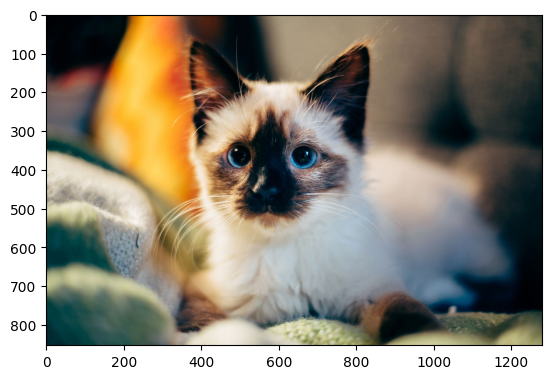

In [ ]:
# Update the image
img = skimage.io.imread('data/kitty-baseline.jpg')      #Tamaño de la imagen 1280px * 853 px apróximadamente

plt.imshow(img)
type(img)

# Save the image
np.save('data/img.npy', img)

In [ ]:
image_path = 'data/kitty-baseline.jpg'

image = cv2.imread(image_path)

- La siguiente función divide una imagen en ***tiles*** más pequeñas de un tamaño dado, calcula el valor medio y la desviación estándar de los píxeles en cada *tile* y devuelve estos datos en una lista. Estas estadísticas podrán ser útiles para analizar variaciones en diferentes partes de la imagen.

In [ ]:
def calculate_tile_statistics(image, tile_size):
    rows, cols = image.shape[:2]
    tile_stats = []

    for row in range(0, rows, tile_size):
        for col in range(0, cols, tile_size):
            tile = image[row:row+tile_size, col:col+tile_size]
            mean = np.mean(tile)
            std_dev = np.std(tile)
            tile_stats.append((mean, std_dev))

    return tile_stats

- Se desarrollará la siguiente función:

 > **tile_based_histogram_equalization**(image, tile_size) esta función de procesamiento de imágenes fue diseñada para mejorar el contraste de una imagen utilizando una técnica llamada **ecualización de histograma** basada en tiles (o baldosas). Esta función procesa una imagen mejorando su **contraste** de forma localizada por secciones, devolviendo la imagen con un ***contraste optimizado*** y ***colores originales preservados.***

In [ ]:
def tile_based_histogram_equalization(image, tile_size):
    # Convert to YCrCb color space
    ycrcb_image = cv2.cvtColor(image, cv2.COLOR_BGR2YCrCb)
    y_channel, cr, cb = cv2.split(ycrcb_image)

    # Apply histogram equalization to the Y channel
    rows, cols = y_channel.shape
    for row in range(0, rows, tile_size):
        for col in range(0, cols, tile_size):
            tile = y_channel[row:row+tile_size, col:col+tile_size]
            y_channel[row:row+tile_size, col:col+tile_size] = cv2.equalizeHist(tile)

    # Merge channels and convert back to RGB
    equalized_ycrcb = cv2.merge([y_channel, cr, cb])
    equalized_image = cv2.cvtColor(equalized_ycrcb, cv2.COLOR_YCrCb2BGR)

    return equalized_image

- La siguiente función:
> **detect_edges**(image, tile_size) procesará la imagen para detectar bordes en ella. Esta función retorna*** edge_detected_image***, que es la imagen original con los bordes detectados en cada bloque utilizando el algoritmo de Canny en bloques individuales de la imagen y compone una imagen final con todos los bordes detectados.

In [ ]:
def detect_edges(image, tile_size):
    rows, cols = image.shape
    edge_detected_image = np.zeros_like(image)

    for row in range(0, rows, tile_size):
        for col in range(0, cols, tile_size):
            tile = image[row:row+tile_size, col:col+tile_size]
            edges = cv2.Canny(tile, 100, 200)
            edge_detected_image[row:row+tile_size, col:col+tile_size] = edges

    return edge_detected_image

- La función **contrast_difference_between_blocks** en Python toma una **imagen** y **un tamaño de bloque** (tile_size) como** parámetros**. Su propósito es **calcular la diferencia de contraste** entre bloques adyacentes de la imagen. Cunado itera completamente la imagen, la función retorna **contrast_diff**, un listado englobando todas las distancias de contraste determinadas entre segmentos contiguos de la imagen. Esta operación estudia una imagen dividida en bloques y coteja la intensidad de cada bloque con sus bloques contiguos a la derecha y hacia abajo, ofreciendo un grupo de medidas que muestran los cambios en el contraste a lo largo de la imagen.

In [ ]:
def contrast_difference_between_blocks(image, tile_size):
    rows, cols = image.shape
    contrast_diff = []

    for row in range(0, rows, tile_size):
        for col in range(0, cols, tile_size):
            current_tile = image[row:row+tile_size, col:col+tile_size]
            current_contrast = np.std(current_tile)

            # Check right neighbor
            if col + tile_size < cols:
                right_tile = image[row:row+tile_size, col+tile_size:col+2*tile_size]
                right_contrast = np.std(right_tile)
                contrast_diff.append(abs(current_contrast - right_contrast))

            # Check bottom neighbor
            if row + tile_size < rows:
                bottom_tile = image[row+tile_size:row+2*tile_size, col:col+tile_size]
                bottom_contrast = np.std(bottom_tile)
                contrast_diff.append(abs(current_contrast - bottom_contrast))

    return contrast_diff

- Este código define una función llamada **analyze_block_histograms** que toma dos parámetros: **una imagen** (image) y **un tamaño de tile** o segmento (tile_size). Esta función realizará lo siguiente:

  - Obtiene el número de filas y columnas de la imagen.
  - Crea una lista vacía llamada histograms.
  - Recorre la imagen en segmentos del tamaño especificado por tile_size.
  - Para cada segmento (o tile), calcula su histograma utilizando la función cv2.calcHist de OpenCV.
  - Añade cada histograma calculado a la lista histograms.
  - Al final, devuelve la lista histograms, que contiene los histogramas de todos los segmentos de la imagen.

In [ ]:
def analyze_block_histograms(image, tile_size):
    rows, cols = image.shape
    histograms = []

    for row in range(0, rows, tile_size):
        for col in range(0, cols, tile_size):
            tile = image[row:row+tile_size, col:col+tile_size]
            hist = cv2.calcHist([tile], [0], None, [256], [0, 256])
            histograms.append(hist)

    return histograms

### **- A continuación se realizarán las aplicaciones de las funciones según los tamaños de segmentos dados**

- Con la función **analyze_image_with_tile_size**(image, tile_size) realizaremos el análisis detallado y la mejora de una imagen dividiéndola en bloques mejorarando y analizando detalladamente el contraste, el brillo y la textura de una imagen en un nivel de bloque o segmento.

In [ ]:
# Apply tile-based histogram equalization
tile_sizes = [90, 180, 360, 720]

In [ ]:
from google.colab.patches import cv2_imshow

In [ ]:
def analyze_image_with_tile_size(image, tile_size):
    # Apply tile-based histogram equalization
    equalized_image = tile_based_histogram_equalization(image, tile_size)

    # Convert to YCrCb color space and extract the Y channel
    ycrcb_image = cv2.cvtColor(equalized_image, cv2.COLOR_BGR2YCrCb)
    y_channel = ycrcb_image[:,:,0]

    # Calculate statistics for each tile in the Y channel
    stats = calculate_tile_statistics(y_channel, tile_size)

    # Analyze variance across tiles
    variances = [np.var([stat[1] for stat in stats])]  # Variance of standard deviations
    print(f"Tile size {tile_size}, Contrast Variance across tiles: {variances}")

    # Edge Detection
    edge_image = detect_edges(y_channel, tile_size)
    print(f'Edge Detection for Tile Size {tile_size}:')
    cv2_imshow(edge_image)

    # Local Consistency Checks
    contrast_differences = contrast_difference_between_blocks(y_channel, tile_size)
    average_contrast_diff = np.mean(contrast_differences)
    print(f"Tile size {tile_size}, Average Contrast Difference between Adjacent Blocks: {average_contrast_diff}")

    # Histogram Analysis
    block_histograms = analyze_block_histograms(y_channel, tile_size)

    # Display the equalized image
    print(f'Equalized Image with Tile Size {tile_size}:')
    cv2_imshow(equalized_image)

    for i, hist in enumerate(block_histograms[:5]):
        plt.plot(hist, label=f'Block {i}')
    plt.legend()
    plt.title(f'Block Histograms for Tile Size {tile_size}')
    plt.show()

Se incluirá:

- **Mejorar Contraste Local**
- **Transformación de Color**
- **Estadísticas por Bloque**
- **Detección de Bordes**
- **Consistencia Local**
- **Análisis de Histograma:** Analiza y muestra los histogramas de brillo por bloque, proporcionando una perspectiva detallada de la distribución de intensidades.
- **Visualización:** Muestra la imagen con el contraste mejorado y los resultados de los análisis para una comprensión visual.

Tile size 90, Contrast Variance across tiles: [10.126396755643306]
Edge Detection for Tile Size 90:


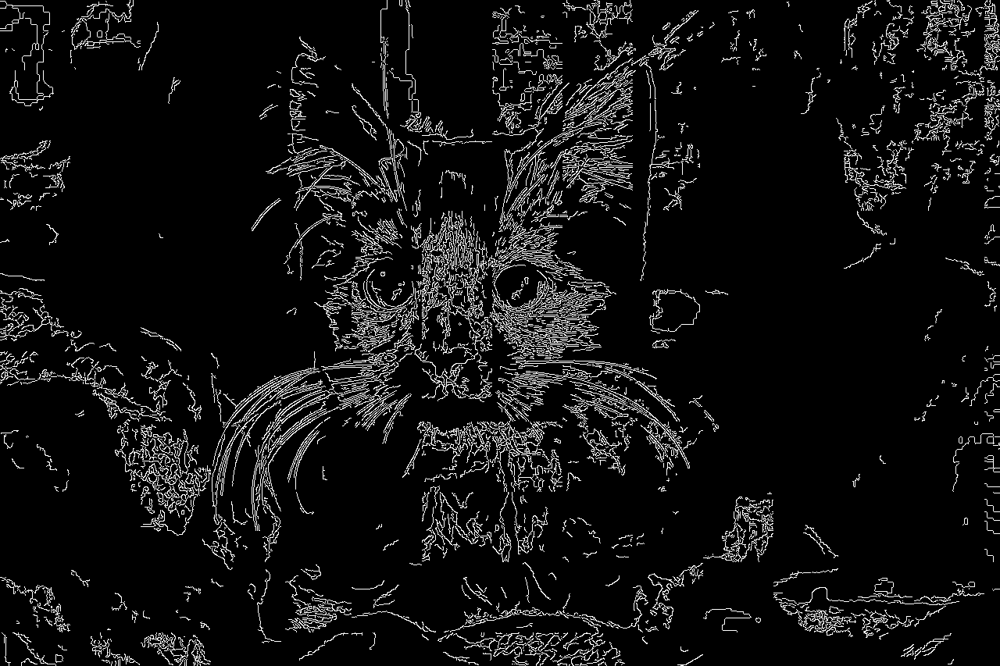

Tile size 90, Average Contrast Difference between Adjacent Blocks: 1.9955445519850374
Equalized Image with Tile Size 90:


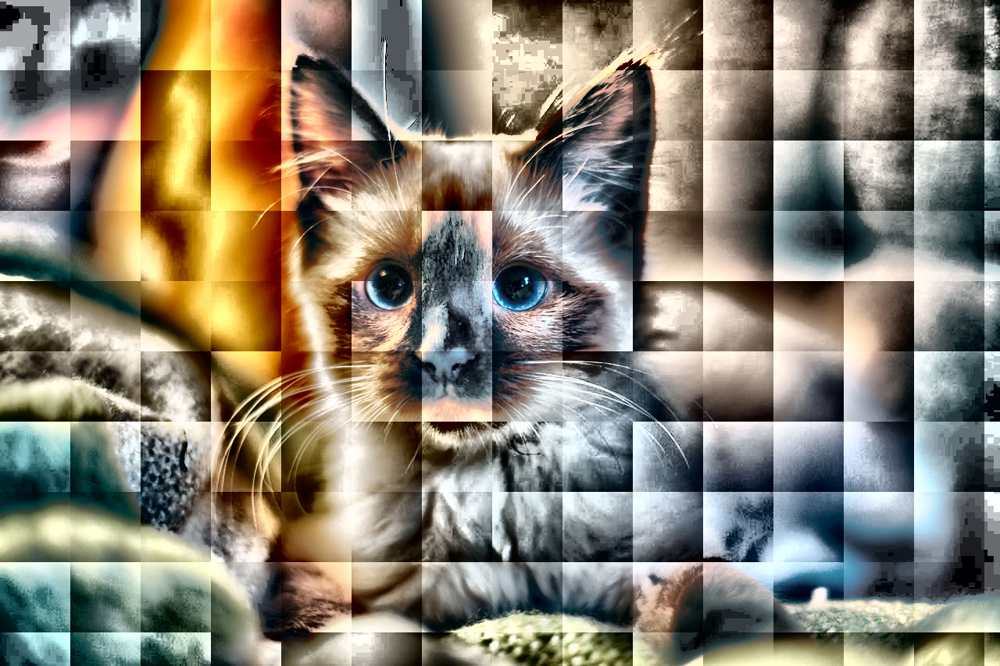

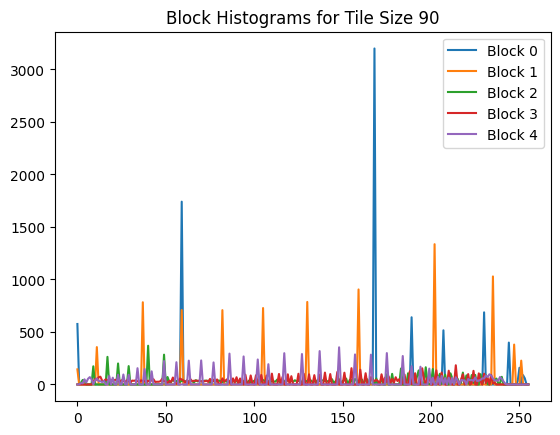

In [ ]:
analyze_image_with_tile_size(image, 90)

Se concluye de lo anterior lo siguiente:

- Se analiza una imagen utilizando un tamaño de **mosaico (tile size) de 90.**
  > La varianza de contraste de los mosaicos y la detección de bordes para un tamaño de mosaico específico (90) o *"Contrast Variance across tiles"* tiene un valor específico de [10.126396755643306], y una detección de bordes o "Edge Detection for Tile Size 90".

  >  - Los mosaicos o bloques en la imagen o datos analizados es de **- TileSize90.**

  > - La medida promedio de la diferencia de contraste entre bloques adyacentes se llama: **- AverageContrastDifference**

  > - Los bloques o mosaicos que están inmediatamente al lado uno del otro en la imagen se denominaron: **- AdjacentBlocks**

 > - El valor numérico específico de la diferencia promedio de contraste es de: **Value1.9955445519850374.**

 > - El proceso o el resultado de la ecualización de la imagen, ajustando el contraste utilizando el tamaño de mosaico de 90 es **EqualizedImage.**

Tile size 180, Contrast Variance across tiles: [6.260557989622785]
Edge Detection for Tile Size 180:


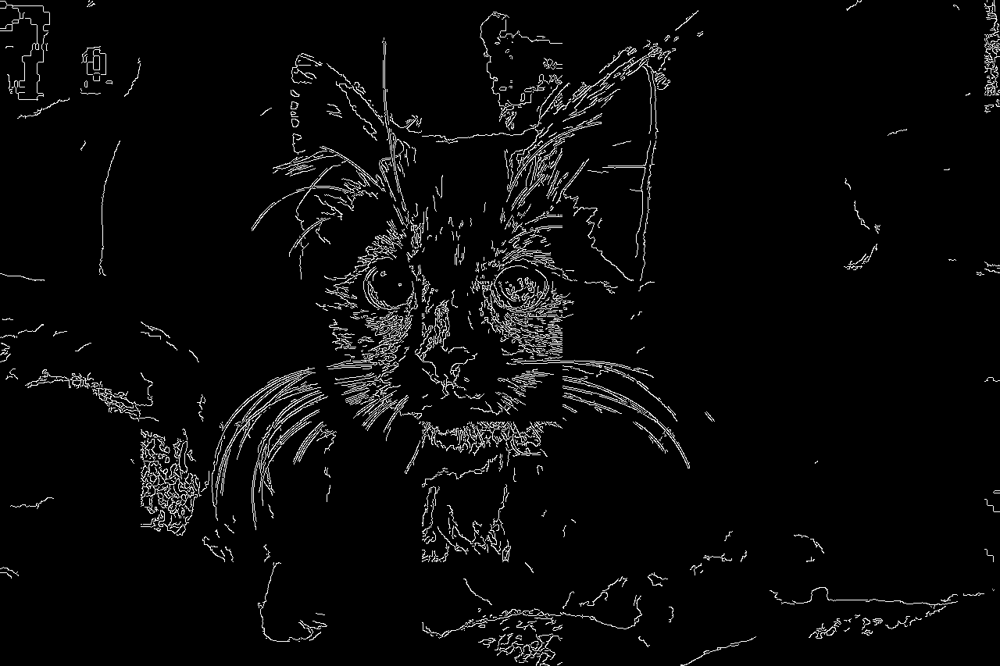

Tile size 180, Average Contrast Difference between Adjacent Blocks: 1.9083694221008938
Equalized Image with Tile Size 180:


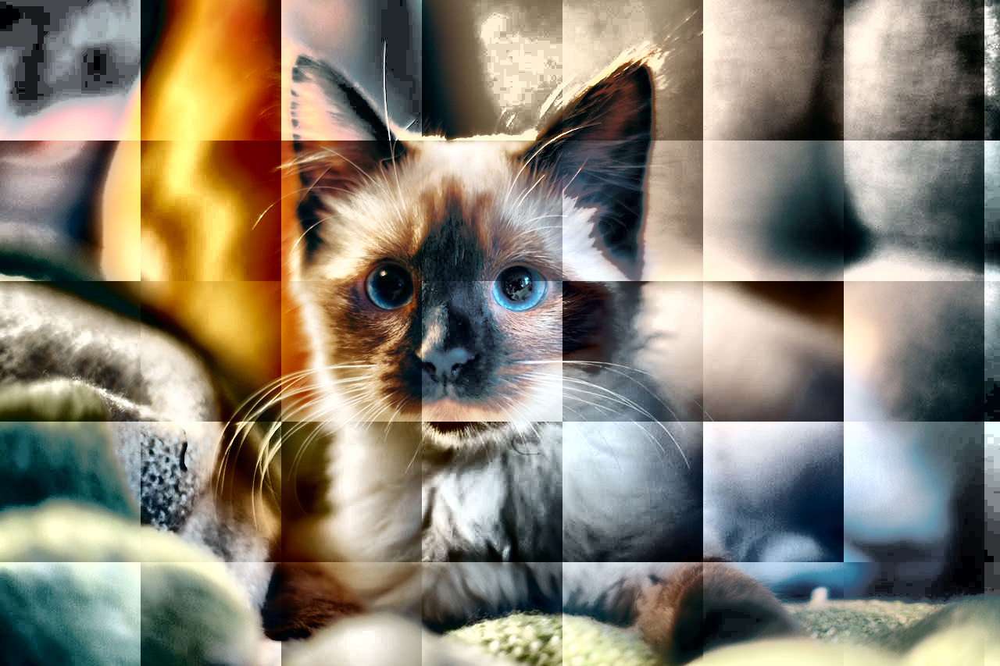

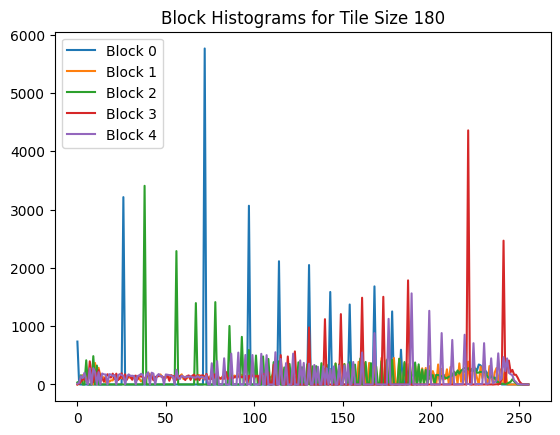

In [ ]:
analyze_image_with_tile_size(image, 180)

Se concluye de lo anterior lo siguiente:

Se analiza una imagen utilizando un tamaño de mosaico (tile size) de 180.
La varianza de contraste de los mosaicos y la detección de bordes para un tamaño de mosaico específico (180) o *"Contrast Variance across tiles"* tiene un valor específico de [6.260557989622785], y una detección de bordes o "Edge Detection for Tile Size 180".

  >  - Los mosaicos o bloques en la imagen o datos analizados es de **- TileSize180.**

  > - La medida promedio de la diferencia de contraste entre bloques adyacentes se llama: **- AverageContrastDifference**

  > - Los bloques o mosaicos que están inmediatamente al lado uno del otro en la imagen se denominaron: **- AdjacentBlocks**

 > - El valor numérico específico de la diferencia promedio de contraste es de: **Value1.9083694221008938**

 > - El proceso o el resultado de la ecualización de la imagen, ajustando el contraste utilizando el tamaño de mosaico de 90 es **EqualizedImage.**

Tile size 360, Contrast Variance across tiles: [0.6643809950047287]
Edge Detection for Tile Size 360:


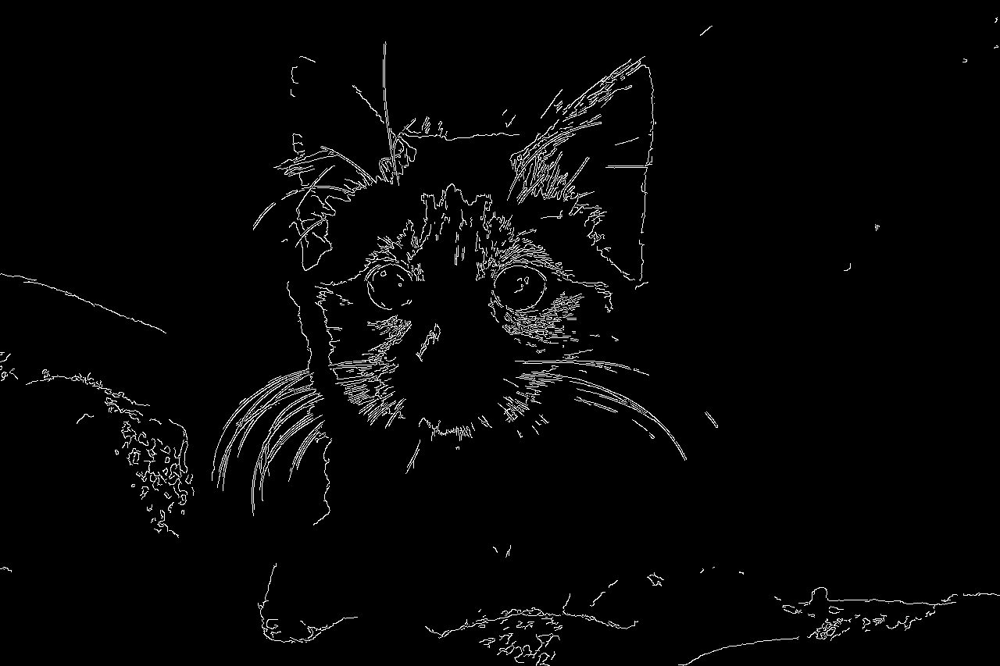

Tile size 360, Average Contrast Difference between Adjacent Blocks: 0.7050715253336013
Equalized Image with Tile Size 360:


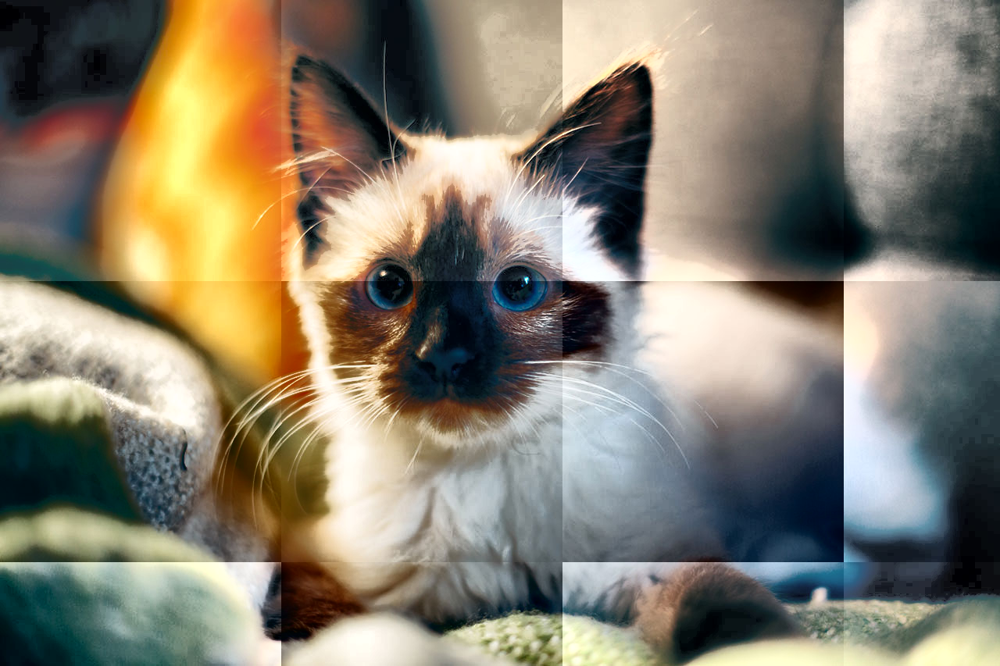

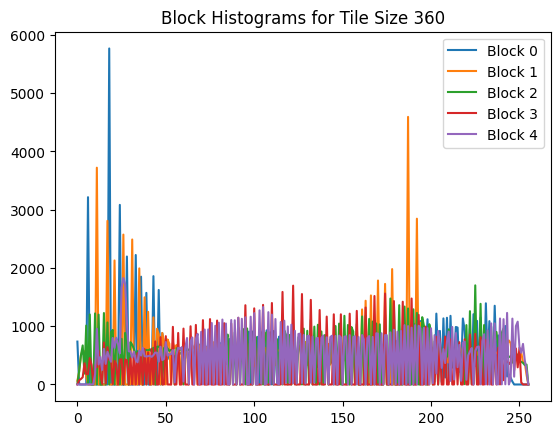

In [ ]:
analyze_image_with_tile_size(image, 360)

Se concluye de lo anterior lo siguiente:

Se analiza una imagen utilizando un tamaño de mosaico (tile size) de 360.
La varianza de contraste de los mosaicos y la detección de bordes para un tamaño de mosaico específico (360) o *"Contrast Variance across tiles"* tiene un valor específico de [0.6643809950047287], y una detección de bordes o "Edge Detection for Tile Size 360".

  >  - Los mosaicos o bloques en la imagen o datos analizados es de **- TileSize 360.**

  > - La medida promedio de la diferencia de contraste entre bloques adyacentes se llama: **- AverageContrastDifference**

  > - Los bloques o mosaicos que están inmediatamente al lado uno del otro en la imagen se denominaron: **- AdjacentBlocks**

 > - El valor numérico específico de la diferencia promedio de contraste es de: **Value 0.7050715253336013**

 > - El proceso o el resultado de la ecualización de la imagen, ajustando el contraste utilizando el tamaño de mosaico de 90 es **EqualizedImage.**

Tile size 720, Contrast Variance across tiles: [0.29138766820222883]
Edge Detection for Tile Size 720:


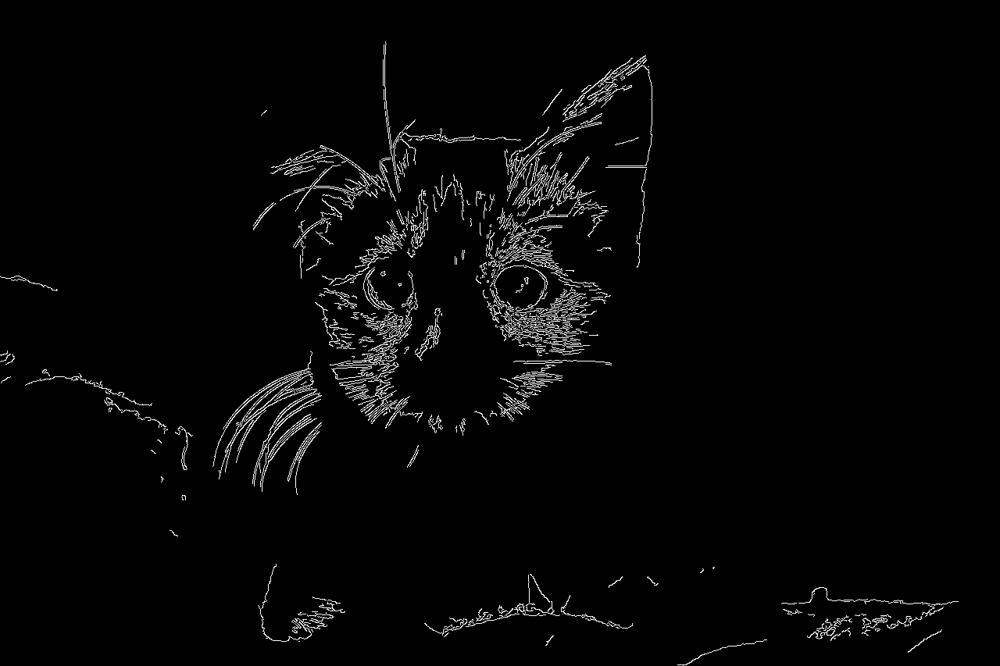

Tile size 720, Average Contrast Difference between Adjacent Blocks: 0.7552953791028258
Equalized Image with Tile Size 720:


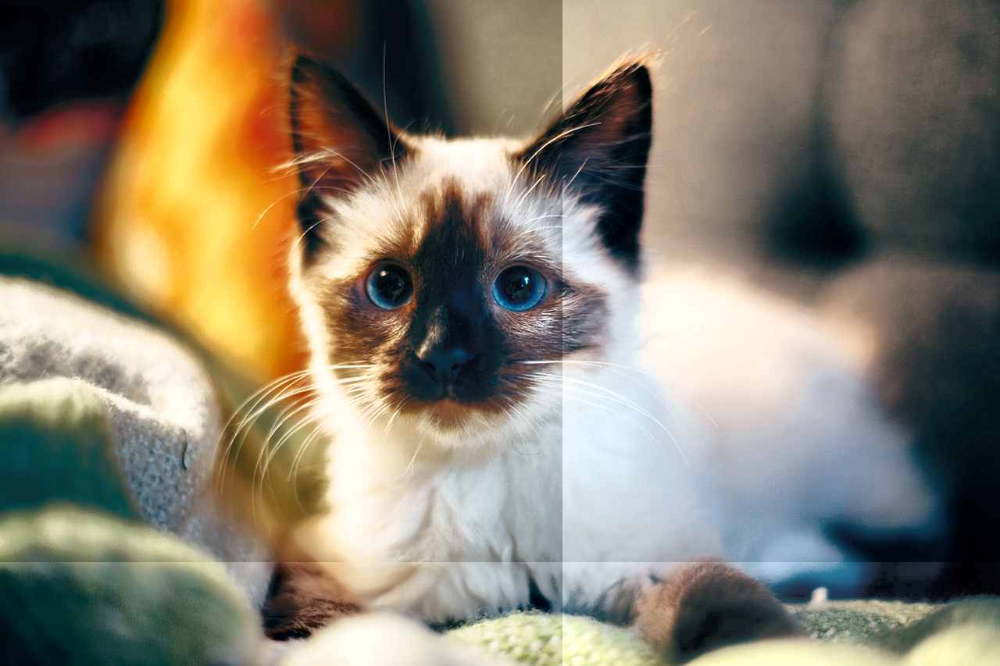

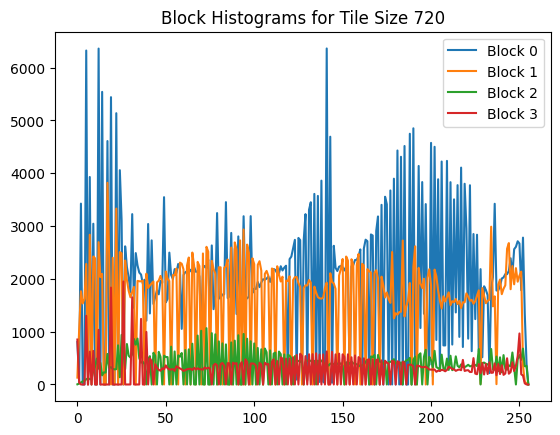

In [ ]:
analyze_image_with_tile_size(image, 720)

Se concluye de lo anterior lo siguiente:

Se analiza una imagen utilizando un tamaño de mosaico (tile size) de 720.
La varianza de contraste de los mosaicos y la detección de bordes para un tamaño de mosaico específico (720) o *"Contrast Variance across tiles"* tiene un valor específico de [0.29138766820222883], y una detección de bordes o "Edge Detection for Tile Size 720".

  >  - Los mosaicos o bloques en la imagen o datos analizados es de **- TileSize 720.**

  > - La medida promedio de la diferencia de contraste entre bloques adyacentes se llama: **- AverageContrastDifference**

  > - Los bloques o mosaicos que están inmediatamente al lado uno del otro en la imagen se denominaron: **- AdjacentBlocks**

 > - El valor numérico específico de la diferencia promedio de contraste es de: **0.7552953791028258**

 > - El proceso o el resultado de la ecualización de la imagen, ajustando el contraste utilizando el tamaño de mosaico de 90 es **EqualizedImage.**

### Como **conclusión general,** se podría decir que entre mayor sea el segmento, menor es el resultado de los bordes, sin embargo, la diferencia promedio de contraste es mayor.

-------------------------------------------------------------------------------------
-------------------------------------------------------------------------------------------

### **2. Investiga e implementa un método sencillo del Sliding Window Adaptive Histogram Equalization (SWAHE) y compara algunas imágenes con diferentes tipos de imágenes.**



#### **- Sliding Window Adaptive Histogram Equalization (SWAHE)**

Para comenzar desglosaremos este método de la siguiente manera:
Inicialmente, el objetivo de la **ecualización del histograma** es distribuir los valores del nivel de grises de la manera más uniforme posible.  Para ello trabaja con la siguiente operación:

$${\displaystyle v(i,j)={\frac {Fu(u(i,j)-Fu(a))}{1-Fu(a)}}(L-1)+0.5}$$

Sin embargo, esta no puede ser manipulada sin ser *especificado el histograma* para poder definirlo y modificarlo según lo requerido, de acuerdo a unos pasos dados.

![Evidence 3](https://i.imgur.com/fRPVDUK.jpg)
> IMG 1. Tomada del libro: Capítulo 6. Procesamiento Digital de Imágenes. R. González y R. Woods. 4° Edición. Pearson.[1]

Ahora bien, para mejorar la calidad de la imagen es necesario aplicar una técnica llamada ACE (Mejora Adaptativa del Contraste), lo cual, para ajustar el contraste de la imagen redistribuye los valores de los pixeles [2] de la siguiente manera:

$$ACE(x,y) = \frac{I(x,y) - G(x,y)}{[G(x,y) + k]}$$

donde I(x,y) es la imagen original, G(x,y) es la imagen filtrada de baja frecuencia, k es una constante de normalización y (x,y) son las coordenadas de los píxeles en la imagen. [3]

> Prácticamente podríamos decir que el método ***Sliding Window Adaptive Histogram Equalization (SWAHE)*** Mejora imágenes, ajusta contraste,redistribuye píxeles, basada en AHE, divide en ventanas, aplicada individualmente, realiza detalles de las imágenes. Al optimizar la calidad ajusta el contraste mediante redistribución de valores en histogramas. Esta es una versión mejorada de AHE, trabaja con secciones menores de imagen para resultados más precisos y detallados, ampliamente empleada en mejora visual de imágenes.

> *"El método utilizado consiste en **especificar un tamaño de bloque** y **mover su centro de un píxel a otro**. En cada ubicación, el píxel central se modifica según su **vecindad local**. Con este método, solo cambia una fila o columna de datos de píxeles a medida que nos movemos a través o hacia abajo de la imagen, lo que permite una implementación eficiente al calcular el histograma. A este método lo llamamos **enfoque de ventana deslizante**, como se muestra en la siguiente Figura:"* [4] *texto en cursiva*


![Evidence 4](https://i.imgur.com/SuqfMkD.jpg)


> **Processing with a sliding window**: (a) Usando una ventana N × N , se realiza la operación y la salida se coloca en la ubicación x , correspondiente al centro de la ventana. (b) La ventana se mueve un píxel hacia la derecha y la operación se realiza nuevamente y el valor procesado se coloca en la imagen de salida en la ubicación correspondiente. (c) al final de la fila, bajamos una fila y repetimos, y (d) este proceso continúa hasta que se procesa toda la imagen. Tenga en cuenta que las filas y columnas exteriores no se procesan.[4]


[1] IMG 1: *Ecualización del histograma* Tomada del libro: Capítulo 6. Procesamiento Digital de Imágenes. R. González y R. Woods. 4° Edición. Pearson.

[2] Programador clic. Artículo: Mejora adaptativa del contraste (ACE). Visto en: https://programmerclick.com/article/63971360507/

[3] PEREGRINA BARRETO, Hayde  y  TEROL VILLALOBOS, Iván R. Mejora de contraste basada en un algoritmo morfológico racional multiescala. Comp. y Sist. [online]. 2011, vol.14, n.3, pp.253-267. ISSN 2007-9737. Visto en: https://www.scielo.org.mx/scielo.php?pid=S1405-55462011000100005&script=sci_abstract

[4] IMG 2. *Processing with a sliding window* Tomada del libro: Capítulo 6. Procesamiento Digital de Imágenes. R. González y R. Woods. 4° Edición. Pearson.


####**Implementación**

In [ ]:
import cv2
from matplotlib import pyplot as plt
import math
import numpy as np

- Se define la función para realizar la impresión de las imágenes, tanto de la original como se explicaba en el texto anterior como la transformada.

In [ ]:
# Función para imprimir las imagenes
def plot_images(orig_img, trans_img):
    plt.figure(figsize=([20, 20]))
    plt.subplot(121),plt.imshow(orig_img)
    plt.title('Imagen Original'), plt.xticks([]), plt.yticks([])
    plt.subplot(122),plt.imshow(trans_img)
    plt.title('Imagen Transformada'), plt.xticks([]), plt.yticks([])

> La siguiente función **swahe** se escribe en Python haciendo uso de la biblioteca **OpenCV** para mejorar el contraste de una imagen.

- En primer lugar, **convertimos** la imagen de entrada al **espacio de color HSV**, separa sus canales y luego se aplica la técnica **CLAHE** a los canales de saturación y valor. CLAHE esta es una técnica que mejora el contraste de diferentes regiones de la imagen. Después, los canales modificados se combinan de nuevo en la imagen HSV, que **se convierte de vuelta al espacio de color BGR**. La función devuelve **la imagen procesada.**

 Ahora, aplicamos la función **swahe** utilizando la función llamada plot_images para mostrar **la imagen original y la procesada** para **compararlas**. Esta función es útil para realizar el contraste de una imagen, especialmente en los canales de saturación y valor.

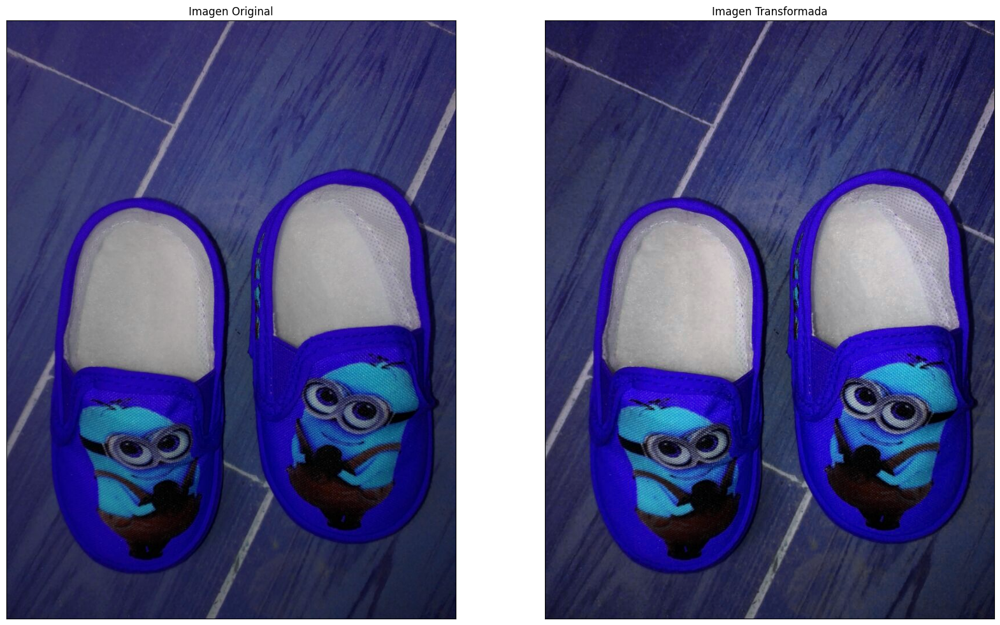

In [ ]:
#Se define la función para SWAHE

def swahe(entrada_imagen):
    # Convertir la imagen a HSV
    hsv = cv2.cvtColor(entrada_imagen, cv2.COLOR_BGR2HSV)
    hue, sat, val = cv2.split(hsv)

    # Ajustar la saturación y los valores de los canales
    clahe = cv2.createCLAHE(clipLimit=1.0, tileGridSize=(2,2))
    sat = clahe.apply(sat)
    val = clahe.apply(val)
    hsv[..., 1] = sat
    hsv[..., 2] = val
    return cv2.cvtColor(hsv, cv2.COLOR_HSV2BGR)

original_img = cv2.imread('data/image.jpg')
swahe_img = swahe(original_img)

plot_images(original_img, swahe_img)

- Definimos la función para el histograma de la imagen.

In [ ]:
def plotRGBHistogram(colorImage):
    color = ('b','g','r')
    for i,col in enumerate(color):
        histr, _ = np.histogram(colorImage[:,:,i],255,[0,255])
        plt.plot(histr,color = col)
        plt.xlim([0,255])
    plt.show()

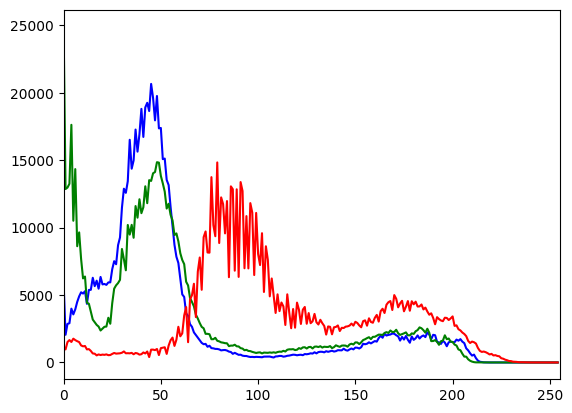

In [ ]:
plotRGBHistogram(swahe_img)

### **3.Investiga cómo funciona el algoritmo CLAHE (contrast limited adaptive histogram equalization) y realiza una implementación (puede ser usando la implementación de OpenCV). Prueba sobre diferentes tipos de imágenes y compara con el método de ecualización de histogramas básico. Provee una breve descripción del método a partir de una  investigación bibliográfica.**

#### **Algoritmo CLAHE (contrast limited adaptive histogram equalization)**

Es una técnica que mejora el contraste de una imagen transformando los valores mediante una ecualización adaptativa de histograma limitada por contraste. Reduce el problema de la amplificación de ruido que ocurre en la ecualización ordinaria de histograma [1].

En CLAHE, la imagen se divide en regiones pequeñas llamadas bloques. Cada bloque se ecualiza por separado utilizando la ecualización de histograma. Sin embargo, para evitar la sobre-amplificación del contraste, se aplica un límite de contraste a cada bloque. Este límite de contraste se determina según el número de píxeles en el bloque y el límite de recorte especificado. El límite de recorte es un valor umbral que limita la mejora máxima de contraste que se puede aplicar a un bloque. Esto asegura que la mejora de contraste no sea demasiado agresiva y que la imagen no se vuelva demasiado ruidosa.

Después de ecualizar los bloques, se combinan mediante interpolación bilineal para eliminar las fronteras artificiales entre ellos. Este algoritmo se puede aplicar para mejorar el contraste de las imágenes en blanco y negro aunque
 también se puede aplicar CLAHE a imágenes en color, para ello generalmente se trasnforman las imagenes al espacio de color LAB o HSV aplicando el ajuste en el canal de luminancia L o V. Los resultados después de ecualizar solo el canal de luminancia de una imagen son mucho mejores que ecualizar todos los canales de la imagen BGR.

## Usos comunes del Algoritmo CLAHE:

**Imágenes Médicas**: CLAHE se utiliza ampliamente en imágenes médicas para mejorar el contraste de las imágenes de rayos X, tomografías computarizadas (CT) y resonancias magnéticas (MRI). Puede contribuir a mejorar la visibilidad de pequeños detalles y estructuras que de otra manera podrían ser difíciles de distinguir [1,3].

**Teledetección**: CLAHE puede emplearse para mejorar el contraste de imágenes satelitales, fotografías aéreas y otros datos de teledetección. Esto puede mejorar la precisión de los algoritmos de clasificación de imágenes y detección de objetos [2].

**Visión por Computadora**: CLAHE se puede utilizar para mejorar el contraste de imágenes en aplicaciones de visión por computadora, como detección de objetos, reconocimiento facial y segmentación de imágenes. Puede contribuir a mejorar la precisión de estos algoritmos al facilitar la distinción entre diferentes objetos y características en una imagen [2].

**Inspección Industrial**: CLAHE puede aplicarse para mejorar el contraste de imágenes en aplicaciones de inspección industrial, como detección de defectos, control de calidad e inspección de superficies. Puede ayudar a mejorar la precisión de estos algoritmos al facilitar la detección de pequeños defectos y anomalías en una imagen [4].

[1]. Adaptive histogram equalization, https://en.wikipedia.org/wiki/Adaptive_histogram_equalization

[2]. Artículo: Image Contrast Enhancement Using CLAHE https://www.analyticsvidhya.com/blog/2022/08/image-contrast-enhancement-using-clahe/

[3]. Ericksen, JP, SM Pizer, JD Austin,
"MAHEM: a Multiprocessor Engine
for Fast Contrast-Limited Adaptive
Histogram Equalization", Medical
Imaging IV: Image Processing,
Volume 1233, SPIE, Bellingham,
WA, 1990.

[4].Real-Time CLAHE Algorithm Implementation in SoC FPGA Device https://www.mdpi.com/2079-9292/11/14/2248/review_report

#### **Implementación**

In [ ]:
import cv2
import matplotlib.pyplot as plt
from io import BytesIO
import matplotlib.pyplot as plt
import requests

In [ ]:
#Se define la función para CLAHE

def clahe(entrada_imagen, cv2_color_space=cv2.COLOR_BGR2LAB):
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))

    # En caso de espacio de color LAB, aplicar CLAHE al canal L (luminancia)
    if cv2_color_space == cv2.COLOR_BGR2LAB:
        # Convertir la imagen al espacio de color seleccionado
        img = cv2.cvtColor(entrada_imagen, cv2_color_space)
        l, a, b = cv2.split(img)
        l = clahe.apply(l)
        clahe_image = cv2.merge([l, a, b])
        clahe_image = cv2.cvtColor(clahe_image, cv2.COLOR_LAB2BGR)

    # En caso de espacio de color HSV, aplicar CLAHE al canal V (Value)
    elif cv2_color_space == cv2.COLOR_BGR2HSV:
        # Convertir la imagen al espacio de color seleccionado
        img = cv2.cvtColor(entrada_imagen, cv2_color_space)
        h, s, v = cv2.split(img)
        v = clahe.apply(v)
        clahe_image = cv2.merge([h, s, v])
        clahe_image = cv2.cvtColor(clahe_image, cv2.COLOR_HSV2BGR)

    # En caso de espacio de escala de grises
    elif cv2_color_space == cv2.COLOR_BGR2GRAY:
        # Convertir la imagen al espacio de color seleccionado
        img = cv2.cvtColor(entrada_imagen, cv2_color_space)
        clahe_image = clahe.apply(img)
        clahe_image = cv2.cvtColor(clahe_image, cv2.COLOR_GRAY2BGR)

    # En caso de espacio de RGB
    elif cv2_color_space == cv2.COLOR_BGR2RGB:
        # Convertir la imagen al espacio de color seleccionado
        img = cv2.cvtColor(entrada_imagen, cv2_color_space)
        r, g, b = cv2.split(img)
        #
        r = clahe.apply(r)
        g = clahe.apply(g)
        b = clahe.apply(b)
        clahe_image = cv2.merge([r, g, b])
        clahe_image = cv2.cvtColor(clahe_image, cv2.COLOR_RGB2BGR)

    else:
      #aplicar a todos los canal
        raise ValueError("Espacio de color no compatible")

    return clahe_image #cv2.cvtColor(clahe_image, cv2.COLOR_BGR2RGB)

In [ ]:
def plot_rgb_histograms(image1, image2):
    fig, axes = plt.subplots(1, 2, figsize=(8, 3))
    color = ('b', 'g', 'r')

    # Imagen 1
    axes[0].set_title('Imagen original')

    for i, col in enumerate(color):
        histr, _ = np.histogram(image1[:, :, i], 255, [0, 255])
        axes[0].plot(histr, color=col)
        axes[0].set_xlim([0, 255])

    # Imagen 2
    axes[1].set_title('Imagen Procesada')

    for i, col in enumerate(color):
        histr, _ = np.histogram(image2[:, :, i], 255, [0, 255])
        axes[1].plot(histr, color=col)
        axes[1].set_xlim([0, 255])

    plt.tight_layout()
    plt.show()


##### **CLAHE aplicado en el espacio de color L*a*b**

In [ ]:
# URL de la imagen en GitHub
url = 'https://github.com/yeivillamil/Team30_CV/blob/main/data/semana_2/alebrije.jpg?raw=true'

# Descargar la imagen desde la URL
response = requests.get(url)
img_data = BytesIO(response.content)

# Convertir los datos a una matriz de imagen
img_original = cv2.imdecode(np.frombuffer(img_data.read(), np.uint8), 1)


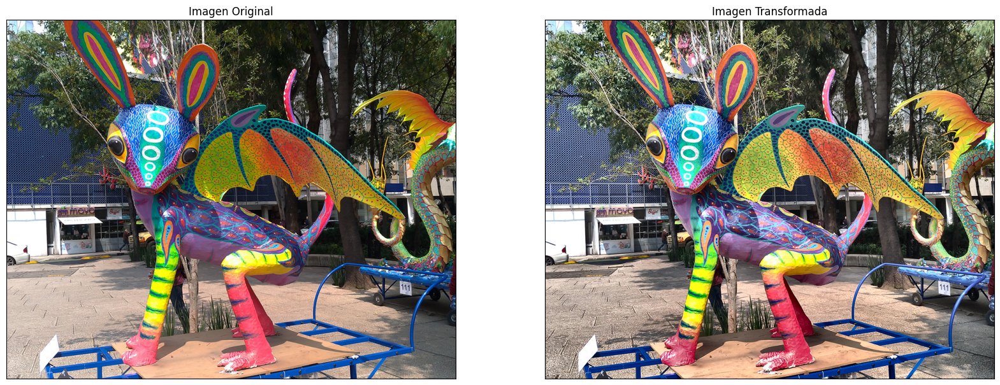

In [ ]:
#Imagen en color aplicando CLAHE al canal de luminancia de L*a*b
clage_lab_img = clahe(img_original,cv2.COLOR_BGR2LAB)
plot_images( cv2.cvtColor(img_original, cv2.COLOR_BGR2RGB), cv2.cvtColor(clage_lab_img,cv2.COLOR_BGR2RGB) )

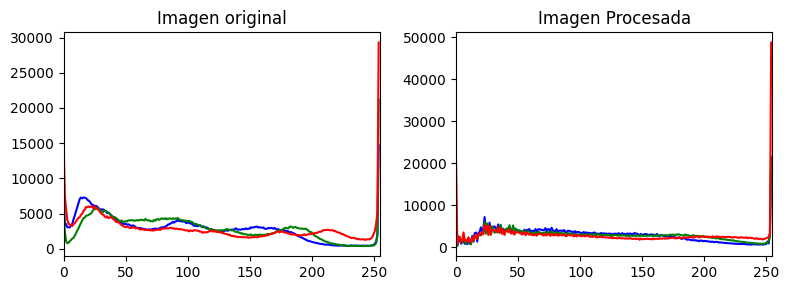

In [ ]:
plot_rgb_histograms(img_original,clage_lab_img)

En este caso hay una perdidad de la saturacion de la imagen pero el contraste revela detalles que no se aprecian a simple vista.

##### **CLAHE aplicado en el espacio de color HSV**

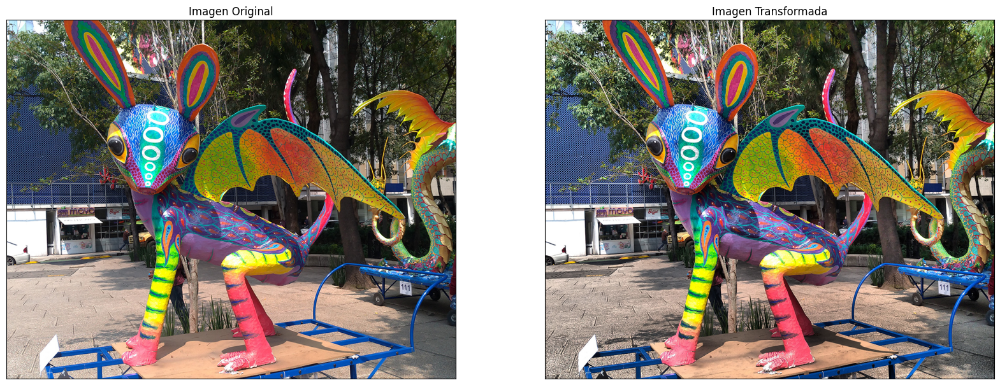

In [ ]:
#Imagen en color aplicando CLAHE al canal de valor de HSV
clage_HSV_img = clahe(img_original,cv2.COLOR_BGR2HSV)
plot_images( cv2.cvtColor(img_original, cv2.COLOR_BGR2RGB), cv2.cvtColor(clage_HSV_img,cv2.COLOR_BGR2RGB) )

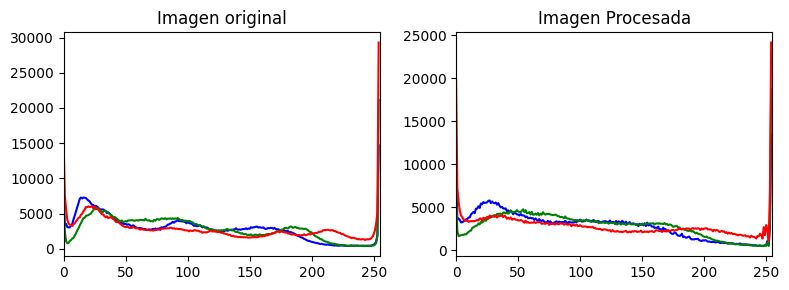

In [ ]:
plot_rgb_histograms(img_original,clage_HSV_img)

En este caso con CLAHE en el canal Value de HSL la imagen mejora sin alterar la saturación ni el balance de la imagen

##### **CLAHE aplicado en blanco y negro** **texto en negrita**

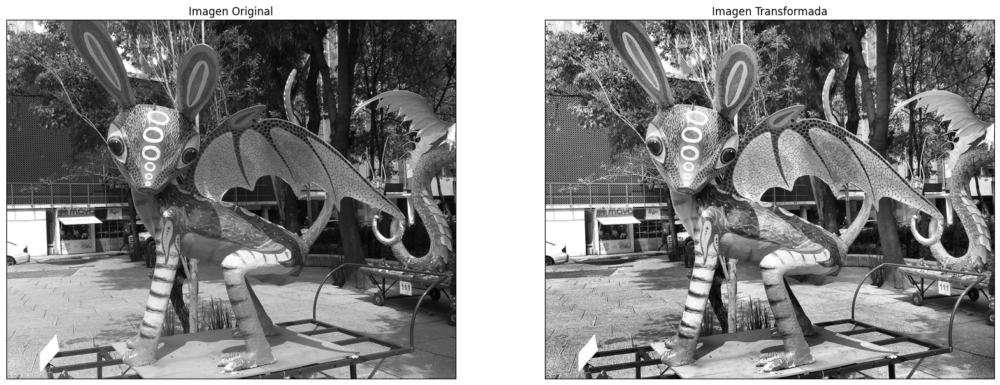

In [ ]:
#Imagen en color aplicando CLAHE con resultado en blanco y negro
clage_bn_img = clahe(img_original,cv2.COLOR_BGR2GRAY)
bn_img =  cv2.cvtColor(img_original, cv2.COLOR_BGR2GRAY)
plot_images( cv2.cvtColor(bn_img, cv2.COLOR_GRAY2BGR), cv2.cvtColor(clage_bn_img,cv2.COLOR_BGR2RGB) )

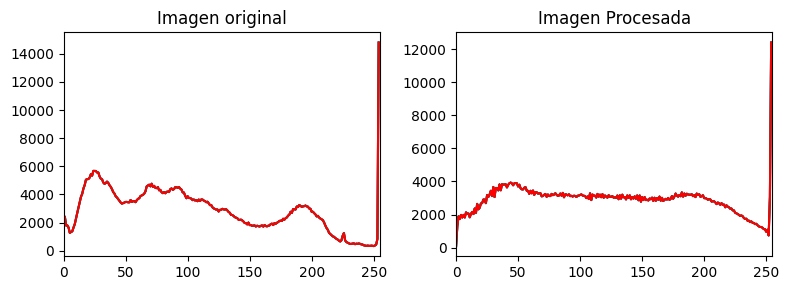

In [ ]:
plot_rgb_histograms(cv2.cvtColor(bn_img, cv2.COLOR_GRAY2BGR),cv2.cvtColor(clage_bn_img,cv2.COLOR_BGR2RGB))

En este caso se aprecia que en la imagen en blanco y negro tiene un contraste mejorado que revela casi la totalidad de los detalles.

##### **CLAHE aplicado a todos los canales**

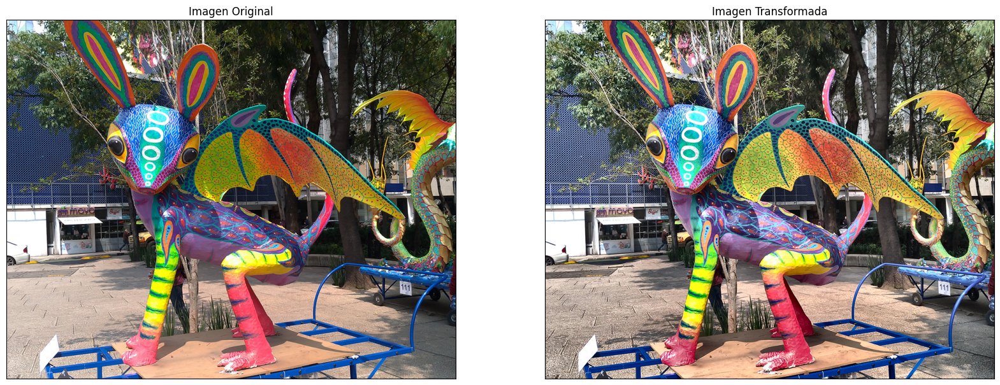

In [ ]:
#Imagen en color aplicando CLAHE a todos los canales
clage_rgb_img = clahe(img_original, cv2.COLOR_BGR2RGB)
plot_images( cv2.cvtColor(img_original, cv2.COLOR_BGR2RGB), cv2.cvtColor(clage_lab_img,cv2.COLOR_BGR2RGB) )

Applicando CLAHE sobre todos los canales exagenra todos los de talles y aparecen distorciones pero se mejora los detalles

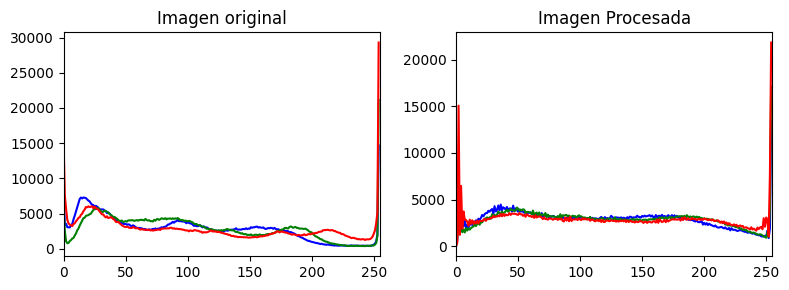

In [ ]:
plot_rgb_histograms(img_original, clage_rgb_img)

# **Conclusiones Generales**

> 1. Las técnicas de ecualización de histograma adaptativa como **Tile-Based Histogram Equalization (TBHE), Sliding Window Adaptive Histogram Equalization (SWAHE) y Contrast Limited Adaptive Histogram Equalization (CLAHE)** son metodologías usadas para mejorar el contraste de imágenes digitales.

> 2. Comparadas con métodos de ecualización de histograma global, estas técnicas adaptativas operan localmente sobre regiones de la imagen, lo cual permite realzar el contraste de una manera más selectiva según las características de cada región. Adicionalmente, métodos como CLAHE aplican limitaciones sobre la amplificación de contraste para controlar el nivel de ruido.

> 3. La elección de la técnica y sus parámetros, como el tamaño de la ventana o región, requiere encontrar un balance entre la habilidad para realzar detalles locales, la complejidad computacional y el nivel de procesamiento requerido. Adicionalmente, se pueden usar técnicas como la interpolación entre regiones para mejorar las transiciones.

> 4. Estas técnicas adaptativas representan algunos de los métodos más efectivos actualmente disponibles para diversas aplicaciones de procesamiento y análisis de imágenes médicas, satelitales y otras imágenes digitales que requieren un realce selectivo de contraste.
